# Scrubbing a Vandalized QR Code

## Python Code Overview

- Environment Management: `uv` - see setup notes in [top-level README](../../README.md)
- I used [Pillow](https://pillow.readthedocs.io/en/stable/) (a.k.a. PIL, a.k.a. Python Imaging Library) to read & transform the image
  - One of the coolest parts is the 

## Background

<details>
<summary>Expand this to see my unrelated rant about why you should include the URL as text alongside your QR code</summary>Quick note, to anyone reading this, if you publish a QR Code in a public place, you should always include the URL it links to in text form. I can't tell you how many times I've seen a QR code, was curious what it pointed to, and didn't end up scanning it. What if someone sends a photo of the QR Code
</details>
<br>
Here's the example QR Code we're using in this exercise.  This is at the South edge of <a href='https://www.atlantaareaparks.com/parks/bessie-branham-park/'>Bessie Branham Park</a> in Kirkwood, Atlanta, GA, US
<br><br>
If you're reading this and think it's interesting/helpful, consider paying it forward by donating $1 to the park fund: <a href='https://parkpride.org/we-can-help/fiscal-sponsor/donate-to-a-local-park/'>parkpride.org > donate to a local park (select "Bessie Branham")</a>

![qr_code_example](original.jpeg)

## Setup & Load Image

In [1]:
from PIL import Image, ImageEnhance, ImageOps
import numpy as np
import pandas as pd

from qr_code_scrub.utility import CustomImage

In [2]:
image = CustomImage.open("original.jpeg")

## Crop Image to Bounding Box

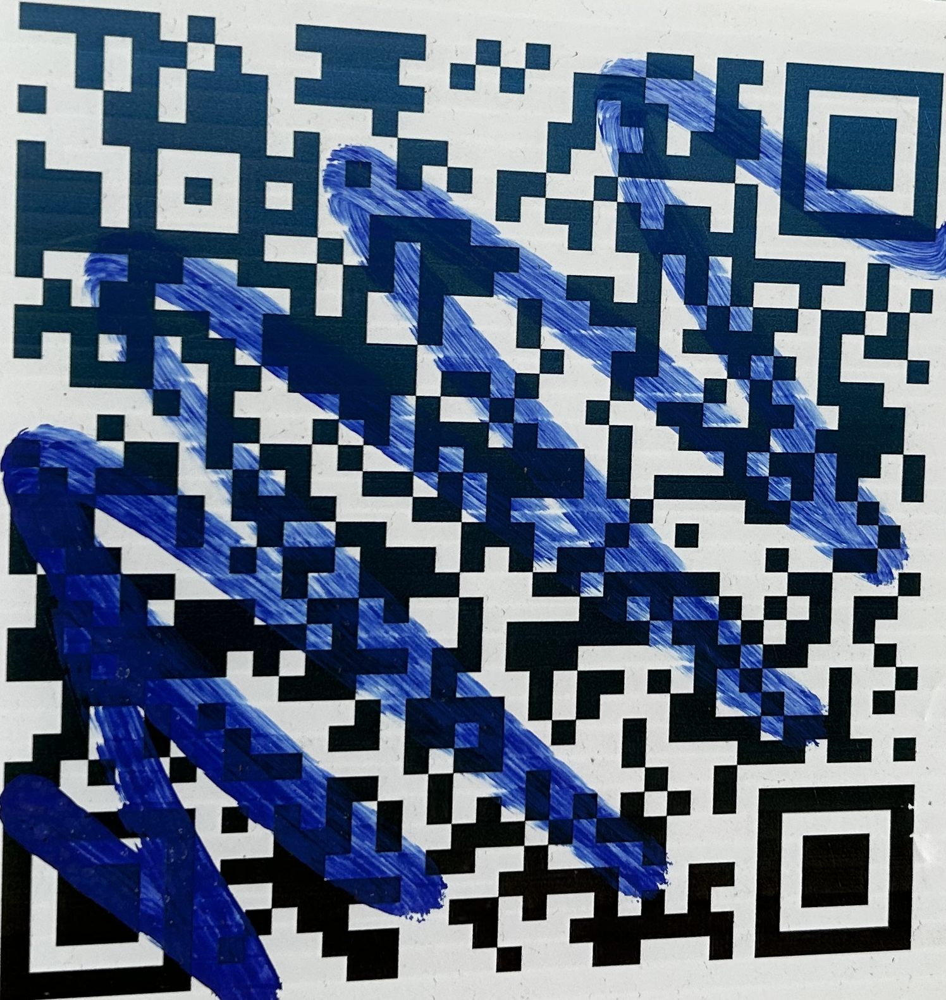

In [3]:
bounding_box = {
    'top_left': (600 + 500, 1102 - 260),
    'bottom_right': (2176 + 420, 2598 - 175)
}

image_cropped = image.crop((
    bounding_box['top_left'][0], # left
    bounding_box['top_left'][1], # top
    bounding_box['bottom_right'][0], # right
    bounding_box['bottom_right'][1], # bottom
))

image_cropped

## Fix perspective skew to fit to 4 corners

I first tried to have it auto-detect the corners, but since this whole thing is a 1-time analysis, I abandoned that approach and just did it manually. Worked pretty well!

I used Mac Preview app to get the corner coords used in next cell: rectangular select each corner and use numbers on screen, which show offset from top-left corner (same coordinate system as PIL)

Note, perspective_tilt is a custom abstraction on a bunch of linear algebra. I might submit this to the Pillow maintainers and see if they want to bring it in.

NGL, I used Claude to generate the underlying code for this one, and it nailed it

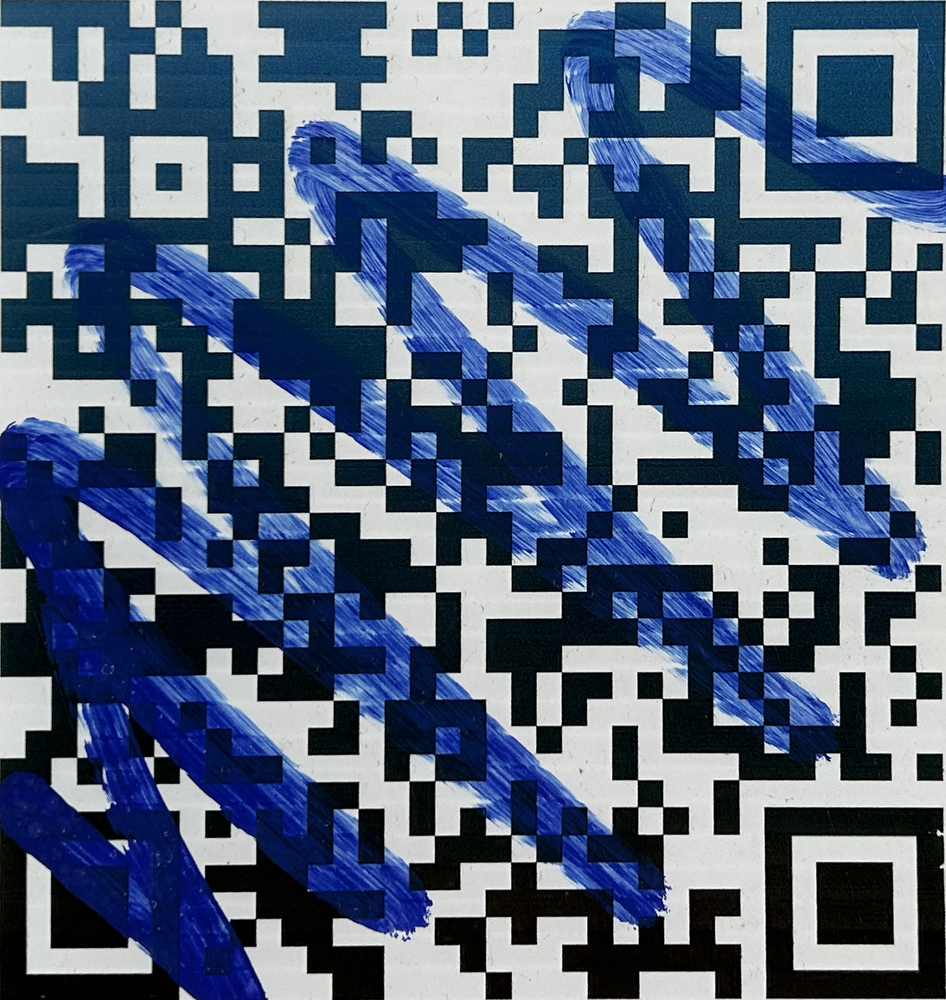

In [4]:
corners = [
    (30, 3),      # top left
    (1493, 115),  # top right
    (1440, 1503), # bottom right
    (0, 1580)     # bottom left
]

image_justified = image_cropped.perspective_tilt(corners)
image_justified

## Rotate image 90 degrees CCW

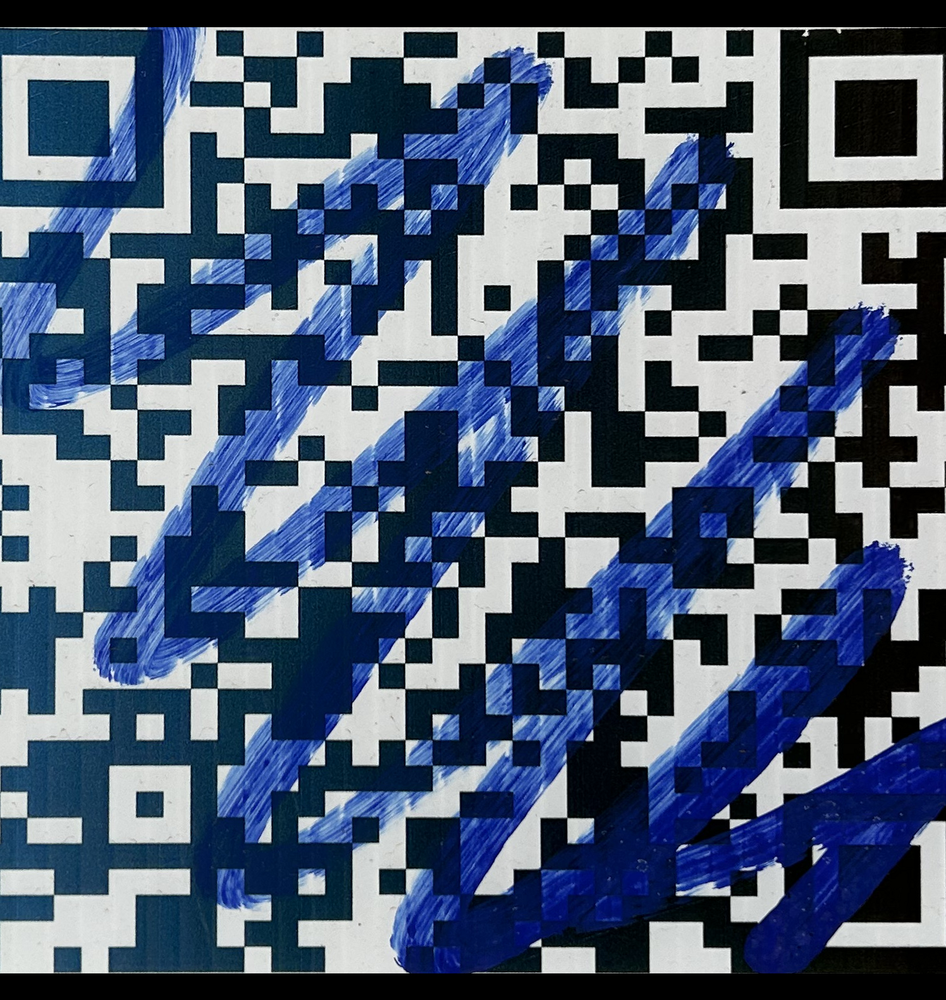

In [5]:
image_rotated = image_justified.rotate(90)
image_rotated

## Convert to grayscale

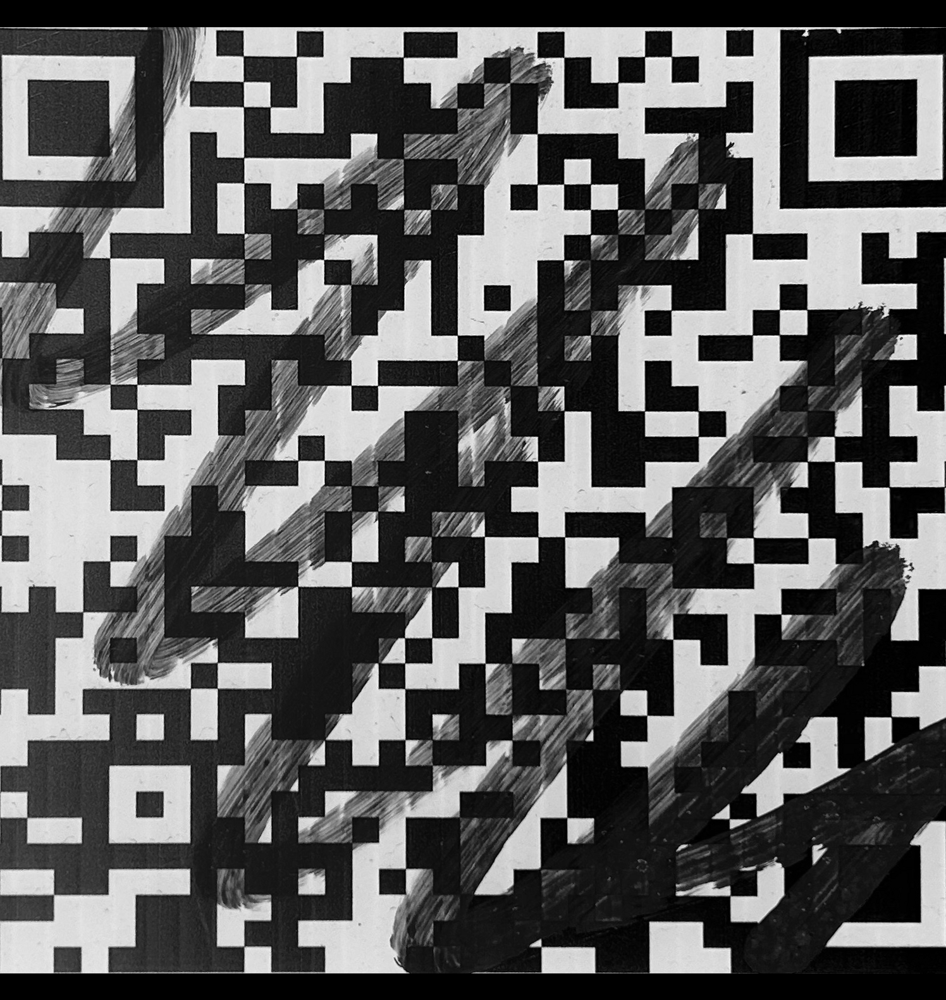

In [6]:
gray_image = ImageOps.grayscale(image_rotated)
gray_image

## Enhance contrast

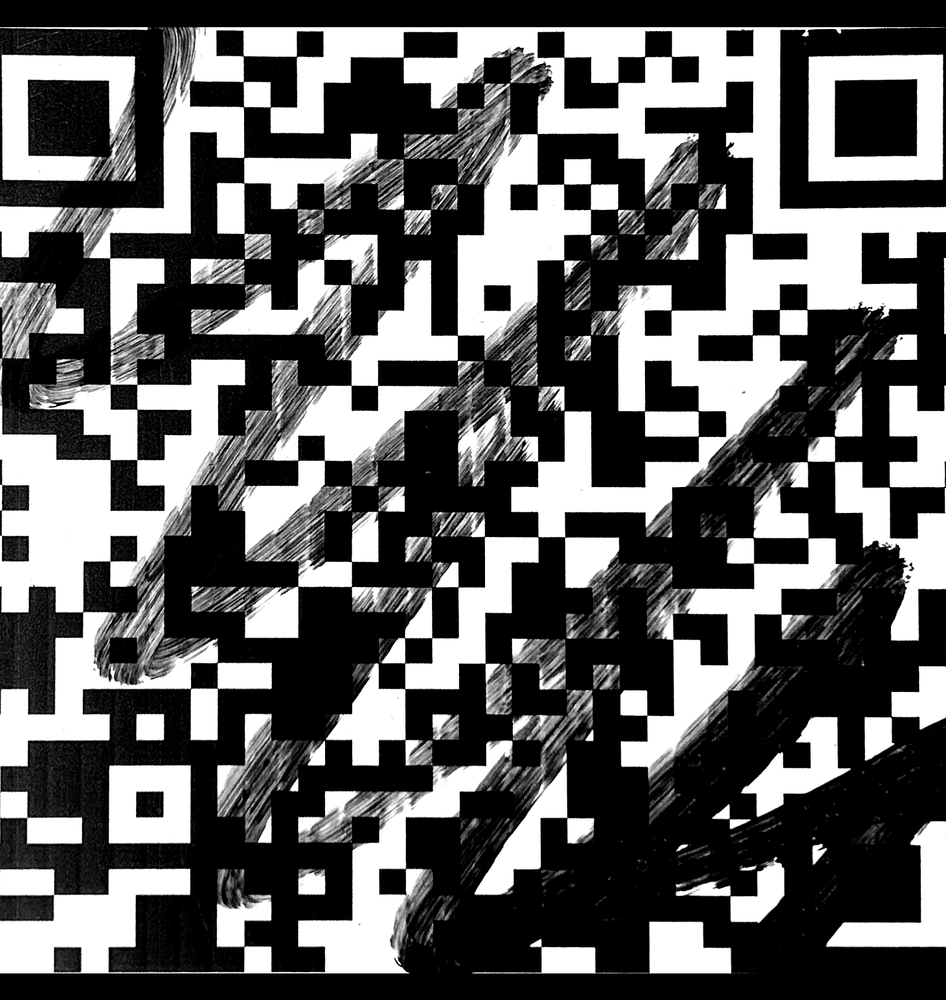

In [7]:
contrast_enhancer = ImageEnhance.Contrast(gray_image)
high_contrast_image = contrast_enhancer.enhance(2.0)  # Increase contrast
high_contrast_image

## Increase Brightness

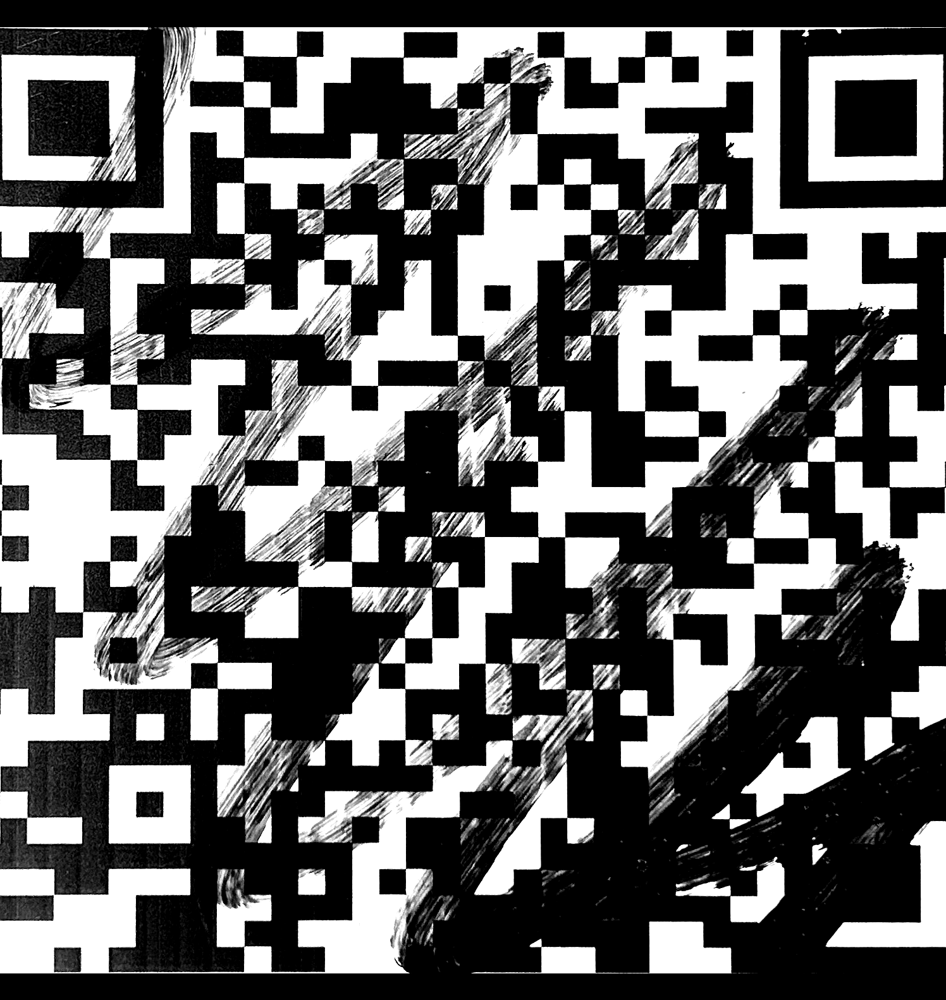

In [8]:
brightness_enhancer = ImageEnhance.Brightness(high_contrast_image)
bright_image = brightness_enhancer.enhance(1.5)
bright_image

## Apply threshold to binarize

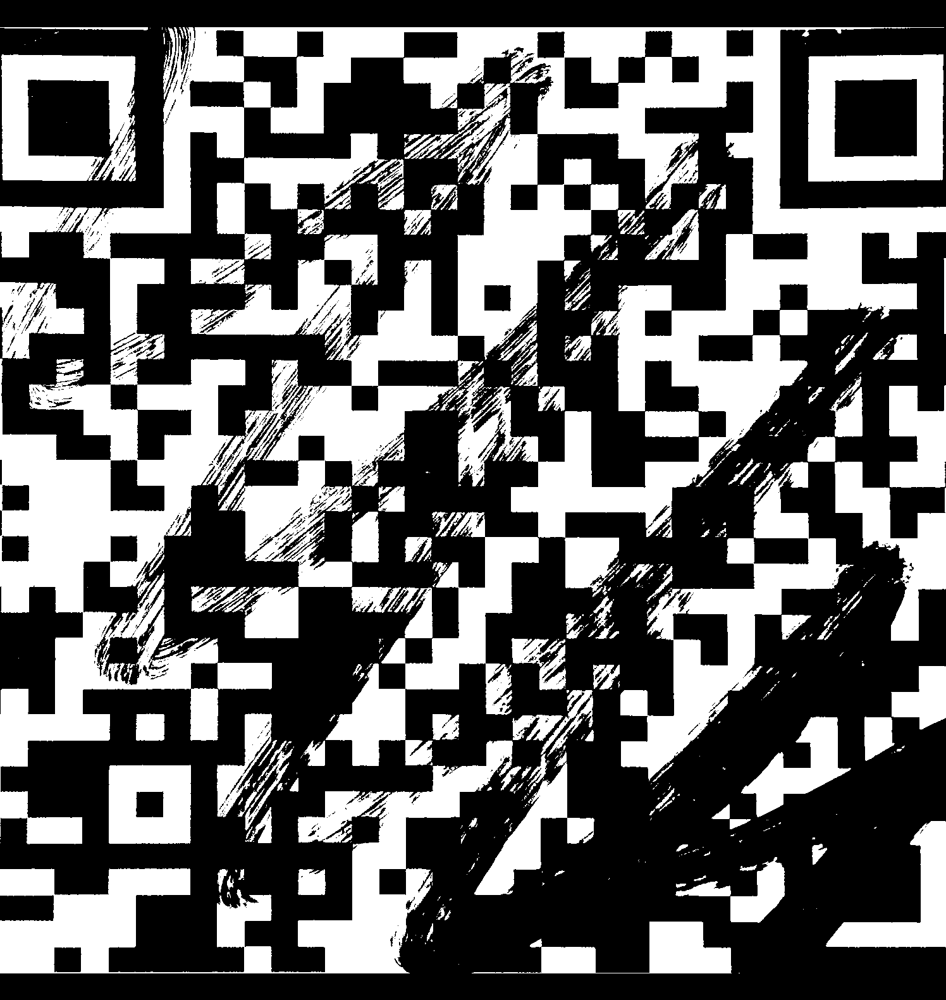

In [9]:
threshold_image = bright_image.point(lambda p: p > 128 and 255)
threshold_image

## Divide into grid and extract data

There may be functionality in a Python QR Code module to do this next part, but what is shown here works for now

The next cell quantizes the image into N x N chunks, where N is determined by the [QR Code version](https://www.qrcode.com/en/about/version.html). In this case, it's a v5 QR Code, so N=37

Thresholds:
- Black is < 128 --> "1"
- White is > 200 --> "0"
- 128 to 200 is ambiguous --> "?"

In [10]:
grid_size = 37 # Setting this up for version 5 example
width, height = threshold_image.size
cell_width = width // grid_size
cell_height = height // grid_size

qr_data = []

for i in range(grid_size):
    row = []
    for j in range(grid_size):
        # Crop each cell from the thresholded image
        cell = threshold_image.crop((j * cell_width, i * cell_height,
                                      (j + 1) * cell_width, (i + 1) * cell_height))
        # Determine if cell is predominantly black or white
        avg_color = np.array(cell).mean()
        if avg_color < 128:
            row.append(1)  # Black module
        elif avg_color > 200:
            row.append(0)  # White module
        else:
            row.append('?')  # Damaged/unknown module due to vandalism
    qr_data.append(row)

for row in qr_data:
    print(row)

# Save to CSV (to be imported to Google Sheets)
pd.DataFrame(qr_data).to_csv('image_scanned.csv')

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1, 1, 1, 1, 1, 1, 1, '?', '?', 1, 0, '?', 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, '?', 0, 0, '?', '?', 0, '?', 1, 0, 1, 1, 1, 1, 1, 1]
[0, 0, 0, 0, 0, 1, 1, 0, 0, '?', 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, '?', '?', 1, '?', '?', '?', '?', 1, 0, 0, 0, 1, 0, 0, 0, 0, 0]
[0, 1, 1, 1, '?', 1, 1, '?', 1, 1, '?', 1, 0, 1, 1, 1, 1, 0, 1, '?', 1, '?', 1, 1, '?', 0, 0, 0, '?', 1, 0, 1, 0, 1, 1, 1, '?']
[0, 1, 1, 1, '?', 1, '?', 0, 0, '?', 1, 0, 0, 1, 1, 1, 1, 1, '?', '?', 1, '?', 0, 0, 0, '?', 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, '?']
[0, 1, 1, 1, '?', 1, '?', '?', 1, '?', 1, 1, 1, 1, 0, 1, '?', 1, '?', '?', 0, 1, 1, 1, '?', 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, '?']
['?', 0, 0, '?', '?', 1, '?', '?', 1, 1, 0, 0, 0, 0, '?', '?', 1, 1, 1, 0, 0, 1, '?', 1, 1, 1, '?', 1, 1, 1, 0, 1, 0, 0, 0, 0, '?']
[1, 1, 1, 1, 1, 1, '?', '?', 1, '?', 1, '?', 1, 1, 1, '?', 1, 1, 1, 0, 1, '?', 1, '?', 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1

## Import CSV into Google Sheet and "draw" on the grid to fix it

This part was a wee bit tedious, but all the above transformations got me about 70% of the way there

I put the images side-by-side as shown below, and used a piece of cardboard to look at it line-by-line

Google Sheets setup:
![](google_sheets_conf_format.png)

Conditional formatting to color cells:
<br>
<img src="conditional_formatting.png" alt="Google Sheets conditional formatting settings" width="250" height="400">

## It now scans as a QR code, success!

Full url this one resolves to (you can test it yourself): https://parkpride.org/we-can-help/fiscal-sponsor/donate-to-a-local-park/

![working_qr_code.jpg](working_qr_code.jpg)

![success_kiid.jpg](success_kid.jpg)

(image credit: https://imgflip.com/memegenerator/Success-Kid)

Here's the final, cleaned QR code:

<img src="working_qr_code_cropped.png" width=500>